In [1]:
import json
import sys
from collections import Counter
from itertools import cycle
from pathlib import Path

import dabest
import matplotlib.pyplot as plt
import seaborn as sns
import mne
import numpy as np
import pandas as pd
import yaml

from mne.time_frequency import tfr_morlet, psd_multitaper, psd_welch
from mne_bids.read import read_raw_bids
from mne_bids import BIDSPath
from rerf.rerfClassifier import rerfClassifier
from scipy.io import loadmat
from scipy.spatial.distance import euclidean
from scipy import stats
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    auc, 
    accuracy_score, 
    cohen_kappa_score, 
    make_scorer, 
    plot_confusion_matrix, 
    roc_auc_score, 
    roc_curve
)
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold, TimeSeriesSplit
from sklearn.preprocessing import MinMaxScaler, LabelBinarizer, label_binarize
from tqdm import tqdm

from move_experiment_functions import fit_classifiers_cv, get_event_data

if os.path.abspath("../io") not in sys.path:
    sys.path.append(os.path.abspath("../io"))

from read import read_dataset, read_label, read_trial, get_trial_info
from utils import NumpyEncoder
from experiments import run_classifier_comparison, cv_fit
from plotting import (
    plot_roc_multiclass_cv,
    plot_feature_importances,
    plot_cv_indices, 
    plot_classifier_performance,
    plot_roc_aucs,
    plot_accuracies,
    plot_event_onsets,
    plot_event_durations
)

# plt.style.use(['science', 'ieee', 'no-latex'])
plt.rcParams["font.family"] = "sans-serif"

%load_ext autoreload
%autoreload 2
%matplotlib inline

In [7]:
with open(Path(os.path.abspath('')) / "config.yml") as f:
    config = yaml.load(f, Loader=yaml.FullLoader)

with open(Path(os.path.abspath('')) / "metadata.yml") as f:
    metadata = yaml.load(f, Loader=yaml.FullLoader)

subjects = metadata["subjects"]

bids_root = Path(config["bids_root"])
results_path = Path(config["results_path"])
bids_root, results_path

(PosixPath('/Volumes/Mac/research/data/efri'),
 PosixPath('/Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output'))

In [26]:
nfreqs = 10
lfreq, hfreq = (70, 200)
freqs = np.logspace(*np.log10([lfreq, hfreq]), num=nfreqs)
n_cycles = freqs / 3.0

rng = 1
n_splits = 5
cv = StratifiedKFold(n_splits)
metrics = dict(
    accuracy="accuracy",
    cohen_kappa_score=make_scorer(cohen_kappa_score),
    roc_auc_ovr="roc_auc_ovr",
)

## Event durations/onsets

 33%|███▎      | 3/9 [00:01<00:01,  3.10it/s]Out of 98 trials, there were 96 successful trials in /Volumes/Mac/research/data/efri/sub-efri07/ses-efri/ieeg/sub-efri07_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 155 trials, there were 143 successful trials in /Volumes/Mac/research/data/efri/sub-efri13/ses-efri/ieeg/sub-efri13_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
100%|██████████| 9/9 [00:02<00:00,  3.14it/s]Out of 129 trials, there were 124 successful trials in /Volumes/Mac/research/data/efri/sub-efri26/ses-efri/ieeg/sub-efri26_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.



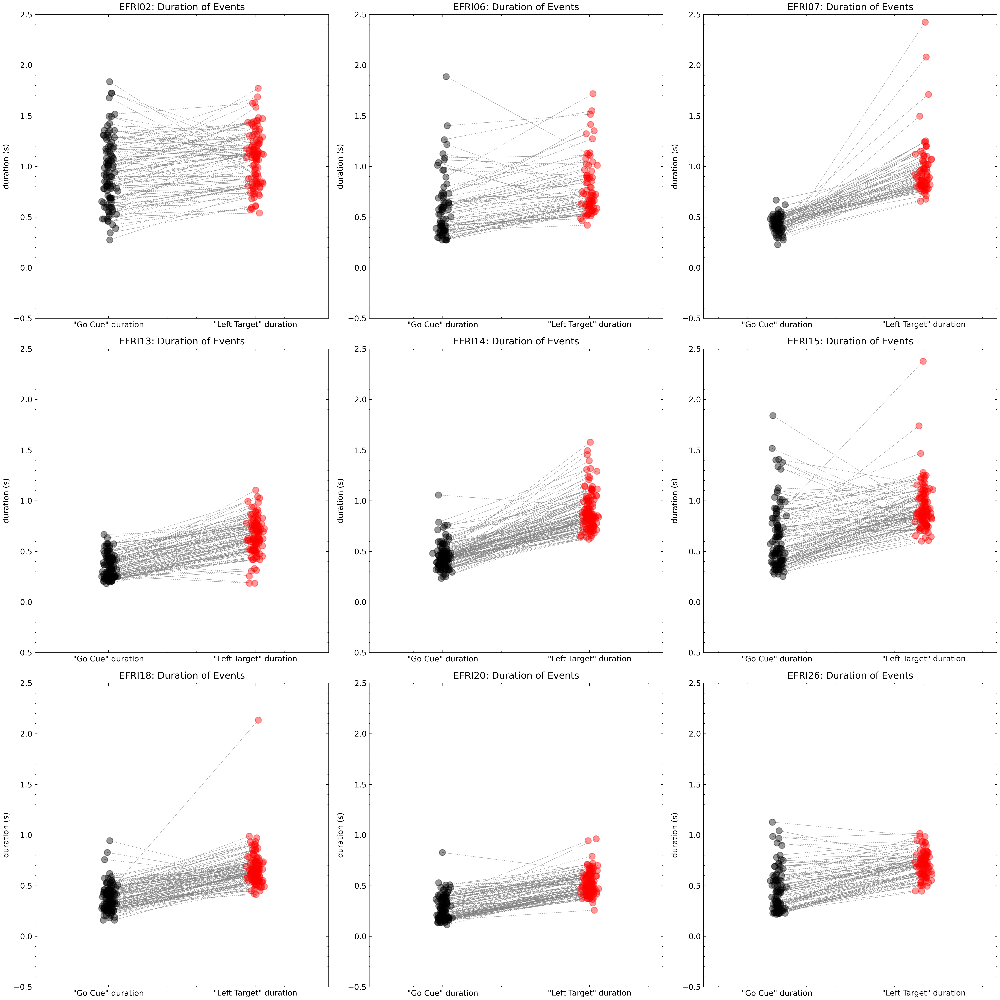

In [28]:
fig, axs = plt.subplots(nrows=3, ncols=3, dpi=300, figsize=(18, 18))
axs = axs.flatten()

for i, subject in enumerate(tqdm(subjects)):
    ax = axs[i]

    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".vhdr",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    behav, events = map(pd.DataFrame, get_trial_info(bids_path))
    plot_event_durations(behav, events, ax=ax, random_state=rng)

    ax.set(ylabel="duration (s)", title=f"{subject.upper()}: Duration of Events")

fig.tight_layout();

 22%|██▏       | 2/9 [00:00<00:02,  3.22it/s]Out of 97 trials, there were 94 successful trials in /Volumes/Mac/research/data/efri/sub-efri06/ses-efri/ieeg/sub-efri06_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 98 trials, there were 96 successful trials in /Volumes/Mac/research/data/efri/sub-efri07/ses-efri/ieeg/sub-efri07_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
100%|██████████| 9/9 [00:03<00:00,  2.96it/s]


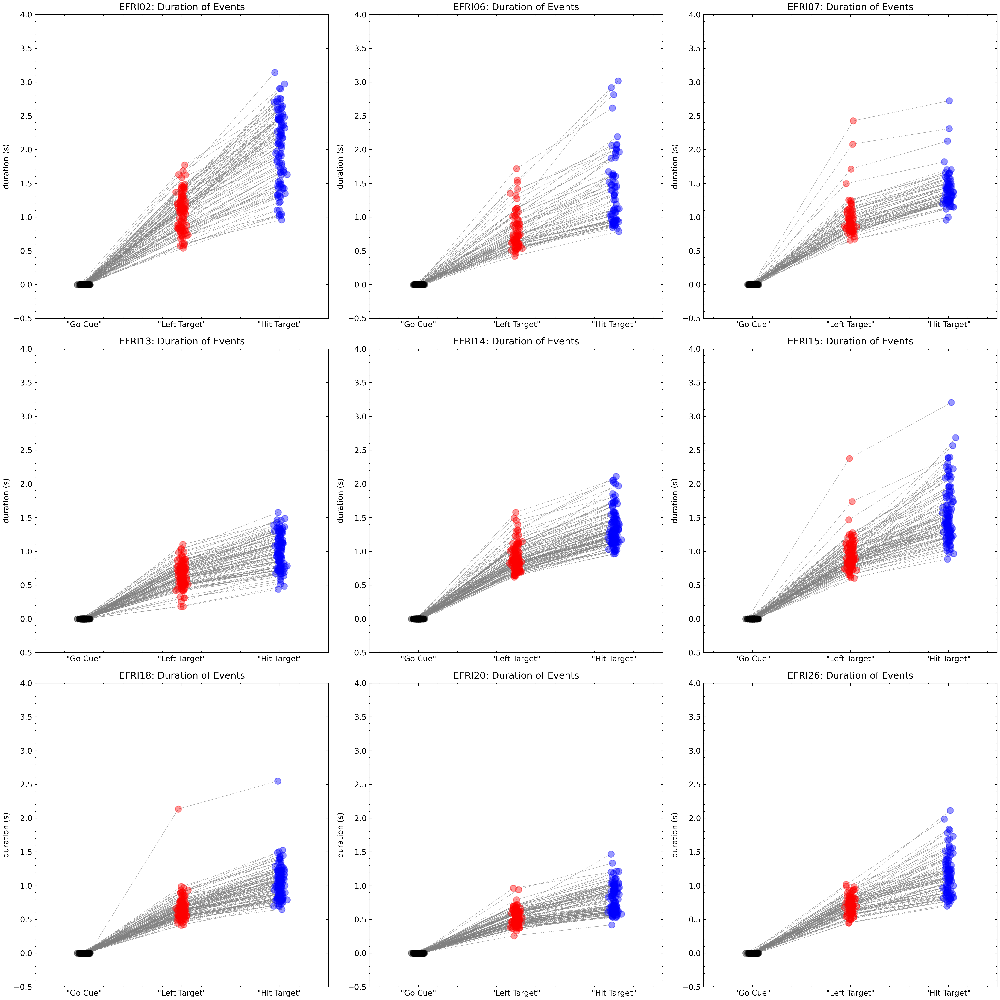

In [29]:
fig, axs = plt.subplots(nrows=3, ncols=3, dpi=300, figsize=(18, 18))
axs = axs.flatten()

for i, subject in enumerate(tqdm(subjects)):
    ax = axs[i]

    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".vhdr",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    behav, events = map(pd.DataFrame, get_trial_info(bids_path))
    plot_event_onsets(behav, events, ax=ax, random_state=rng)

    ax.set(ylabel="duration (s)", title=f"{subject.upper()}: Duration of Events")

fig.tight_layout();

## Globally shortest time window

In [3]:
def get_shortest_event_durations(bids_root, subjects, label_keyword="Left Target"):
    before_duration = np.inf
    after_duration = np.inf
    for subject in subjects:
        path_identifiers = dict(
            subject=subject,
            session="efri",
            task="move",
            acquisition="seeg",
            run="01",
            suffix="ieeg",
            extension=".vhdr",
            root=bids_root
        )
        bids_path = BIDSPath(**path_identifiers)
        behav, events = map(pd.DataFrame, get_trial_info(bids_path))
        events.onset = pd.to_numeric(events.onset)
        behav[["successful_trial_flag", "force_magnitude"]] = behav[
            ["successful_trial_flag", "force_magnitude"]
        ].apply(pd.to_numeric)

        # get successful trials and reset index to match those of events_tsv
        successful_trials = behav[behav.successful_trial_flag == 1]
        successful_trials.index = np.arange(len(successful_trials))
        unperturbed_trial_inds = successful_trials.force_magnitude == 0

        # get left target events and compute time difference with adjacent events
        inds = events.trial_type == label_keyword
        go_cue_duration = events.onset.diff(periods=-1).abs()[inds]
        left_target_duration = events.onset.diff(periods=1)[inds]

        # Remove unsuccessful and perturbed trials
        successful_trials = behav[behav.successful_trial_flag == 1]
        successful_trials.index = go_cue_duration.index
        unperturbed_trial_inds = successful_trials.force_magnitude == 0
        go_cue_duration = go_cue_duration[unperturbed_trial_inds]
        left_target_duration = left_target_duration[unperturbed_trial_inds]

        # update durations if one of the durations for this patient is shorter
        before_duration = min(before_duration, min(go_cue_duration))
        after_duration = min(after_duration, min(left_target_duration))
    
    return before_duration, after_duration

In [4]:
before_duration, after_duration = get_shortest_event_durations(bids_root, subjects)

tmin = -before_duration
tmax = after_duration
print(tmin, tmax)

Out of 135 trials, there were 132 successful trials in /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 97 trials, there were 94 successful trials in /Volumes/Mac/research/data/efri/sub-efri06/ses-efri/ieeg/sub-efri06_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 98 trials, there were 96 successful trials in /Volumes/Mac/research/data/efri/sub-efri07/ses-efri/ieeg/sub-efri07_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 155 trials, there were 143 successful trials in /Volumes/Mac/research/data/efri/sub-efri13/ses-efri/ieeg/sub-efri13_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 163 trials, there were 154 successful trials in /Volumes/Mac/research/data/efri/sub-efri14/ses-efri/ieeg/sub-efri14_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 144 trials, there were 139 successful trials in /Volumes/Mac/research/data/efri/sub-efri15/ses-efri/ieeg/sub-efri15_ses-efri_task-move_acq-seeg_run-01_i

In [6]:
data = dict()
subject_clf_scores = dict()

for subject in tqdm(subjects):
    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".vhdr",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.25, tmax=tmax+0.25)

    power = tfr_morlet(epochs, freqs=freqs, n_cycles=n_cycles, average=False, return_itc=False, decim=3, n_jobs=-1)
    power.crop(tmin=tmin, tmax=tmax)

    power_data = power.data
    ntrials, nchs, nfreqs, nsteps = power_data.shape
    print(ntrials, nchs, nfreqs, nsteps)
    image_height = nchs * nfreqs
    image_width = nsteps

    X = power_data.reshape(ntrials, -1)
    y = labels

    data[subject] = (X, y)

    subject_clf_scores[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

h/data/efri/sub-efri06/ses-efri/ieeg/sub-efri06_ses-efri_task-move_acq-seeg_run-01_channels.tsv.
Reading 0 ... 2525999  =      0.000 ...  1262.999 secs...
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower transition bandwidth: 0.50 Hz
- Upper transition bandwidth: 0.50 Hz
- Filter length: 13201 samples (6.601 sec)

Used Annotations descriptions: ['At Center', 'False Start', 'Go Cue', 'Held Target', 'Hit Target', 'Leave Target', 'Left Target', 'Reserved (End Trial)', 'Reserved (Start Trial)', 'Reward', 'Show Center', 'Speed Fail', 'Speed Feedback', 'Speed Instruction']
Not setting metadata
Not setting metadata
94 matching events found
No baseline correction applied
0 projection items activated
Loading data for 94 events and 1604 original time points ...
0 bad epochs dropped
S

  0%|          | 0/9 [00:00<?, ?it/s]

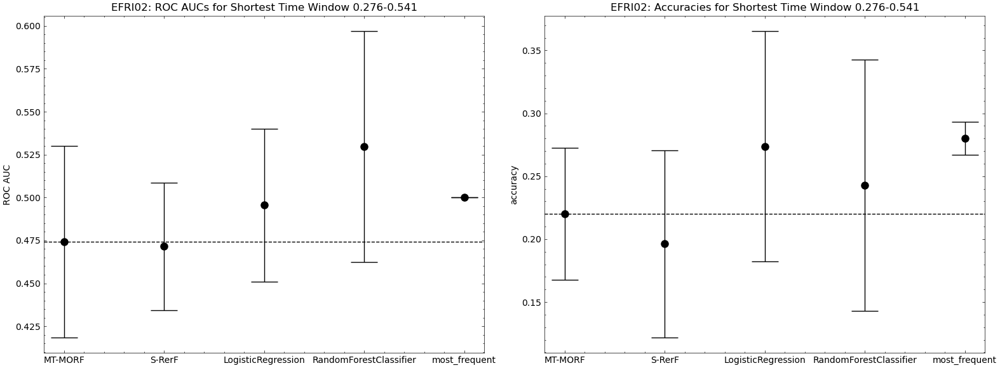

 11%|█         | 1/9 [00:01<00:08,  1.11s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri02/efri02_time_window_tmin=0.276_tmax=0.541_freq_domain.png


<Figure size 432x288 with 0 Axes>

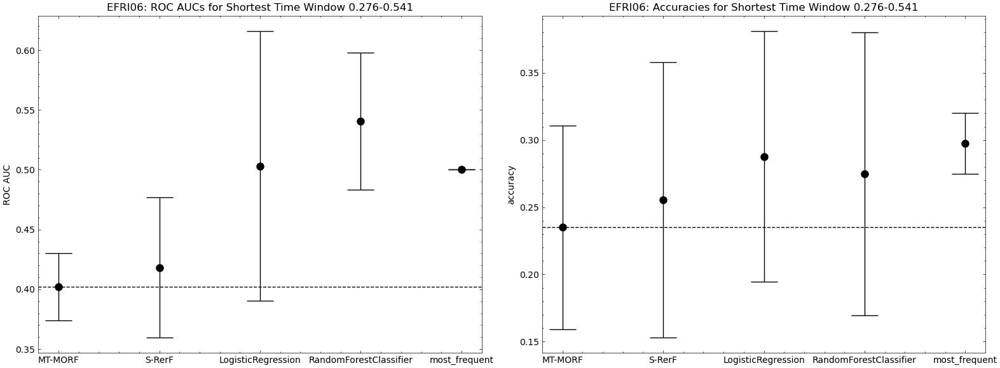

 22%|██▏       | 2/9 [00:02<00:07,  1.09s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri06/efri06_time_window_tmin=0.276_tmax=0.541_freq_domain.png


<Figure size 432x288 with 0 Axes>

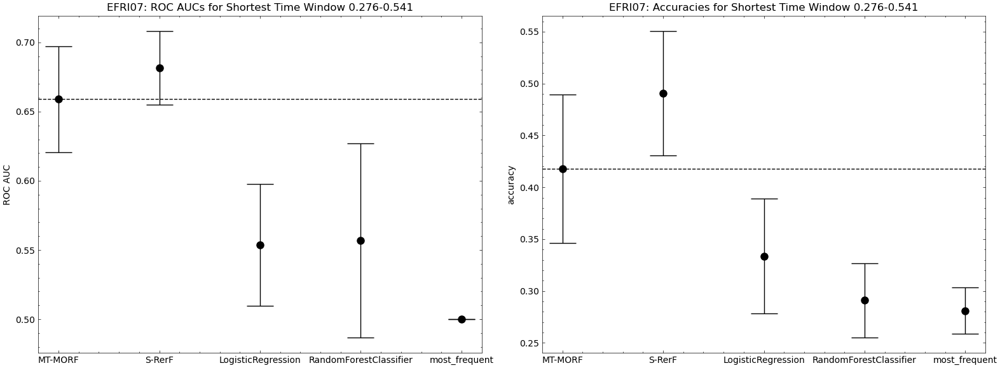

 33%|███▎      | 3/9 [00:03<00:06,  1.12s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri07/efri07_time_window_tmin=0.276_tmax=0.541_freq_domain.png


<Figure size 432x288 with 0 Axes>

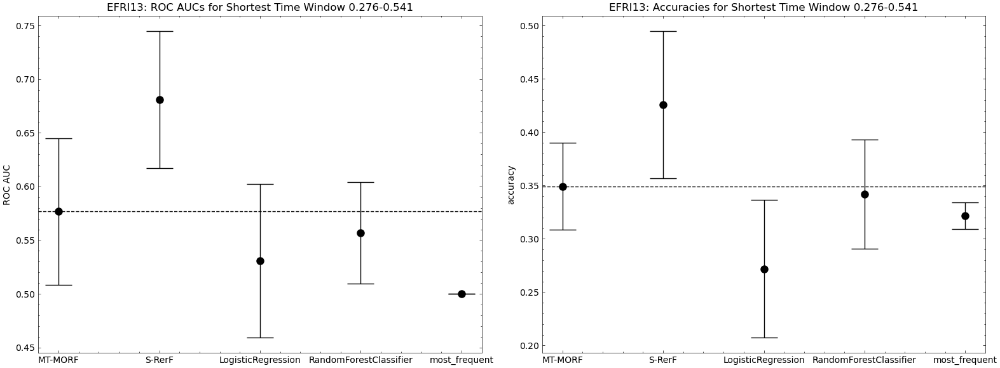

 44%|████▍     | 4/9 [00:04<00:06,  1.21s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri13/efri13_time_window_tmin=0.276_tmax=0.541_freq_domain.png


<Figure size 432x288 with 0 Axes>

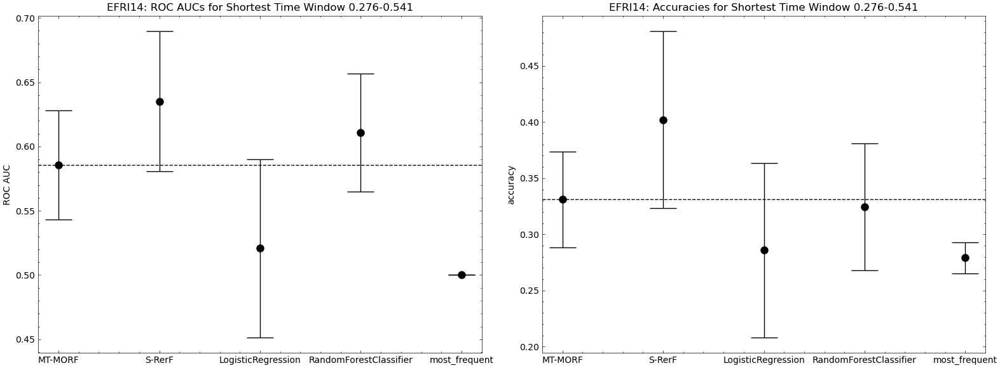

 56%|█████▌    | 5/9 [00:06<00:05,  1.33s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri14/efri14_time_window_tmin=0.276_tmax=0.541_freq_domain.png


<Figure size 432x288 with 0 Axes>

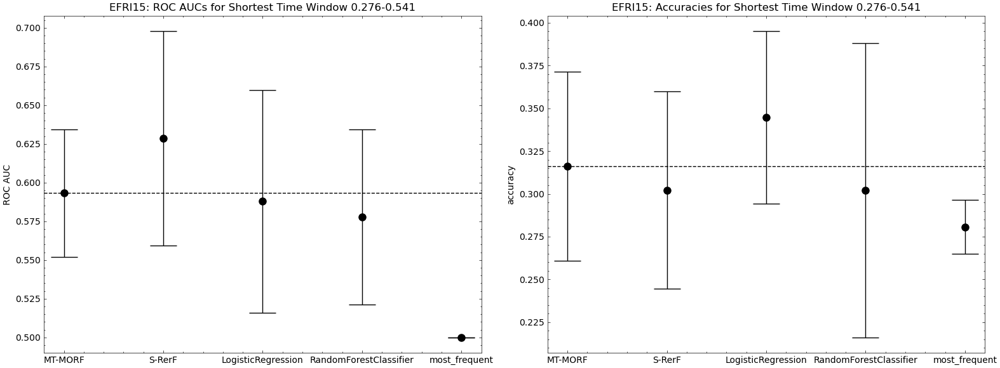

 67%|██████▋   | 6/9 [00:07<00:04,  1.39s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri15/efri15_time_window_tmin=0.276_tmax=0.541_freq_domain.png


<Figure size 432x288 with 0 Axes>

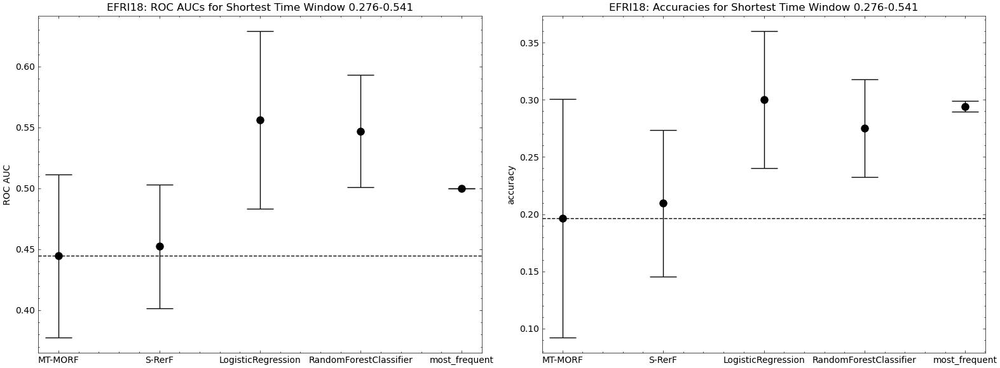

 78%|███████▊  | 7/9 [00:08<00:02,  1.33s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri18/efri18_time_window_tmin=0.276_tmax=0.541_freq_domain.png


<Figure size 432x288 with 0 Axes>

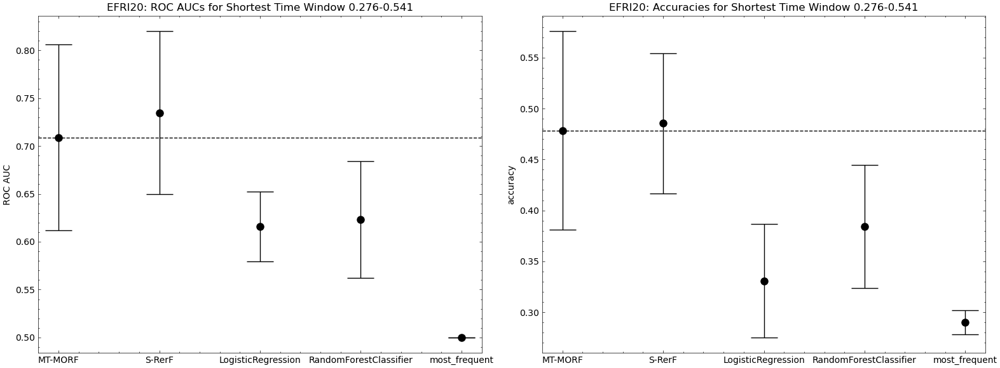

 89%|████████▉ | 8/9 [00:10<00:01,  1.33s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri20/efri20_time_window_tmin=0.276_tmax=0.541_freq_domain.png


<Figure size 432x288 with 0 Axes>

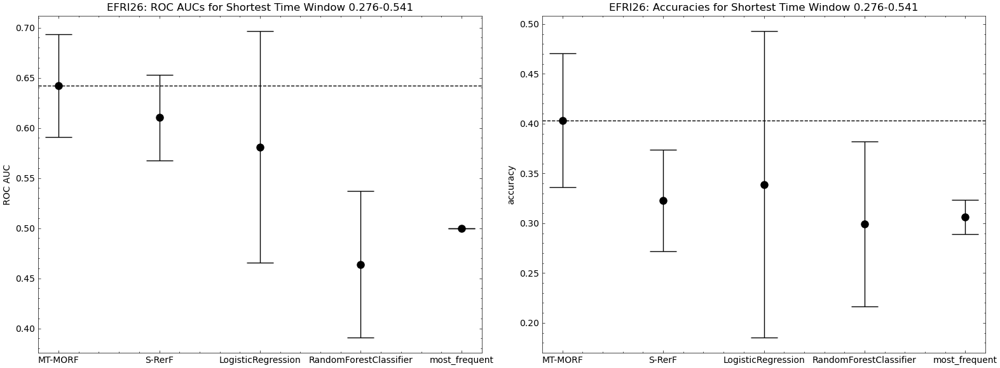

100%|██████████| 9/9 [00:11<00:00,  1.29s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri26/efri26_time_window_tmin=0.276_tmax=0.541_freq_domain.png



<Figure size 432x288 with 0 Axes>

In [30]:
for subject, clf_scores in tqdm(subject_clf_scores.items()):

    destination = results_path / subject

    X, y = data[subject]

    # 1. Plot ROC AUCs
    fig, axs = plt.subplots(ncols=2, dpi=100, figsize=(16, 6))
    axs = axs.flatten()
    plot_roc_aucs(clf_scores, ax=axs[0])
    axs[0].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Shortest Time Window {tmin:.3f}-{tmax:.3f}",
    )

    # 2. Plot accuracies
    plot_accuracies(clf_scores, ax=axs[1])
    axs[1].set(
        ylabel="accuracy",
        title=f"{subject.upper()}: Accuracies for Shortest Time Window {tmin:.3f}-{tmax:.3f}",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")

  0%|          | 0/9 [00:00<?, ?it/s]

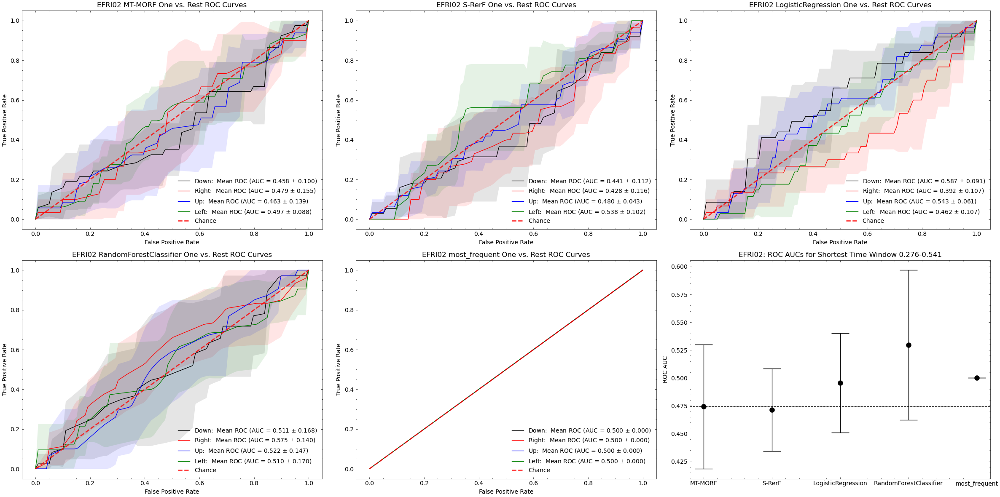

 11%|█         | 1/9 [00:06<00:50,  6.27s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri02/efri02_time_window_tmin=0.276_tmax=0.541_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

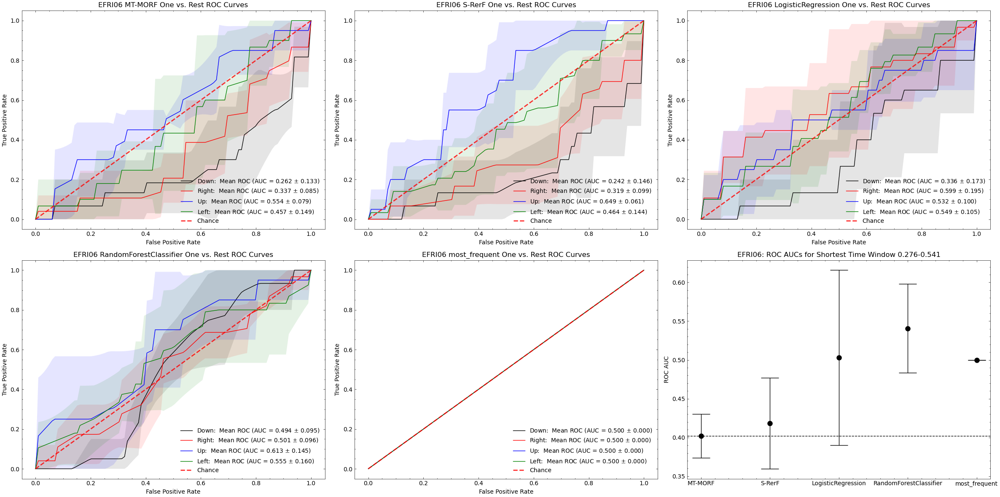

 22%|██▏       | 2/9 [00:11<00:40,  5.82s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri06/efri06_time_window_tmin=0.276_tmax=0.541_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

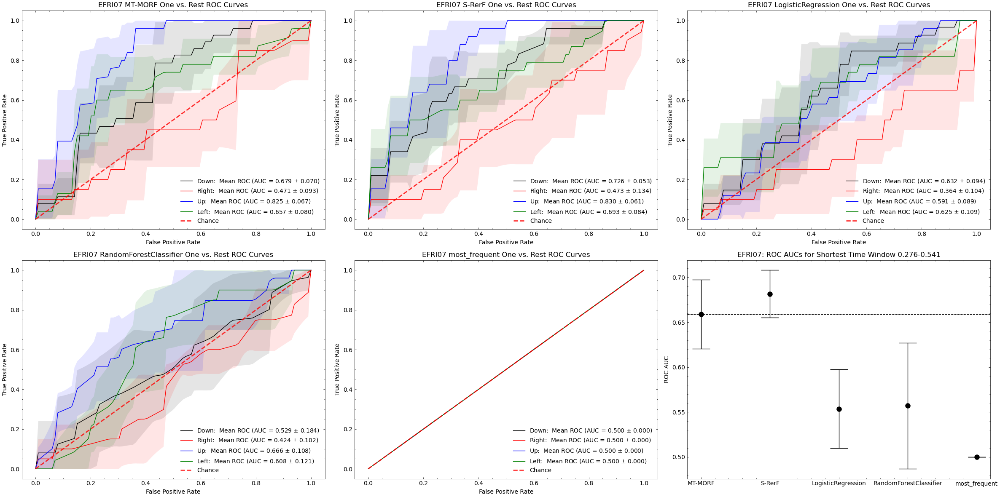

 33%|███▎      | 3/9 [00:17<00:34,  5.78s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri07/efri07_time_window_tmin=0.276_tmax=0.541_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

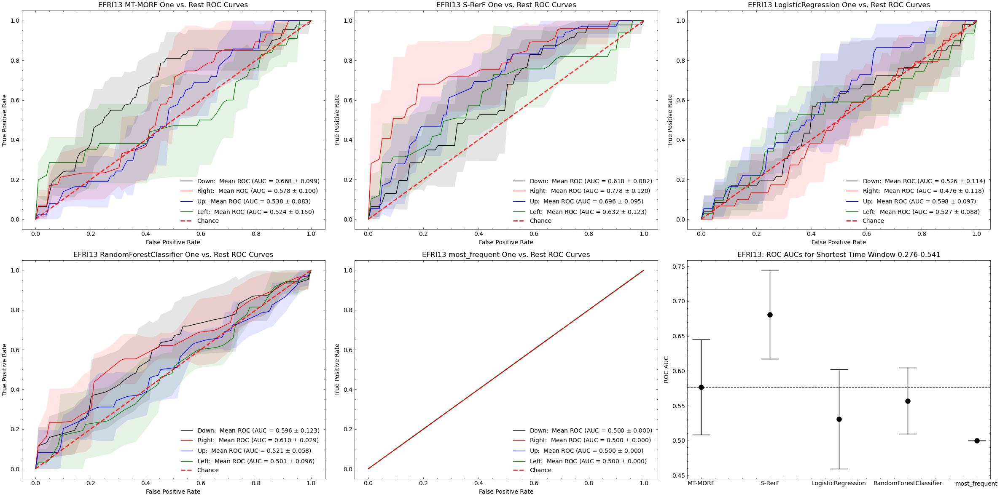

 44%|████▍     | 4/9 [00:23<00:29,  5.86s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri13/efri13_time_window_tmin=0.276_tmax=0.541_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

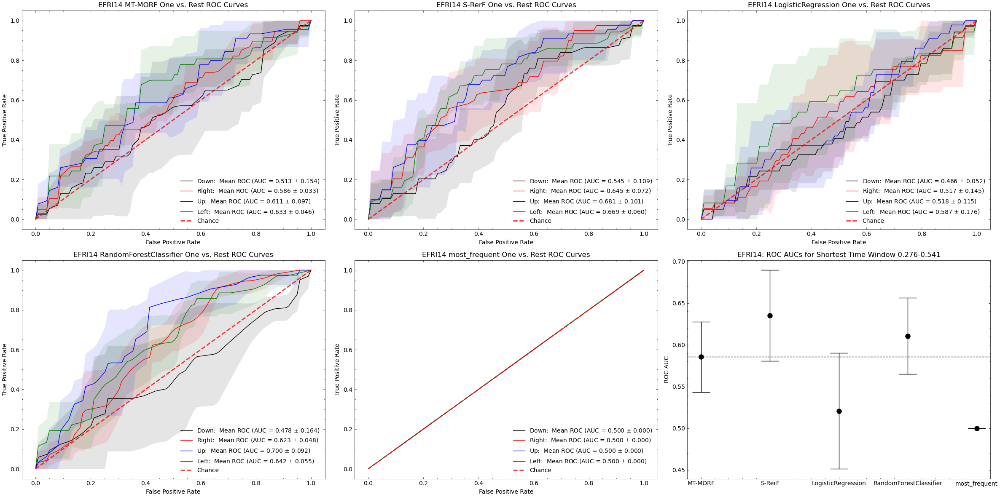

 56%|█████▌    | 5/9 [00:29<00:23,  5.96s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri14/efri14_time_window_tmin=0.276_tmax=0.541_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

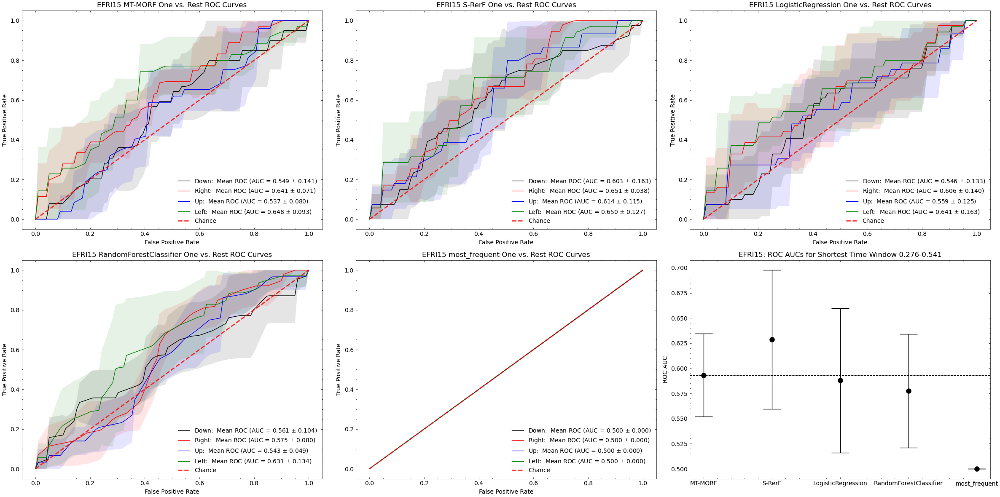

 67%|██████▋   | 6/9 [00:35<00:17,  5.93s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri15/efri15_time_window_tmin=0.276_tmax=0.541_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

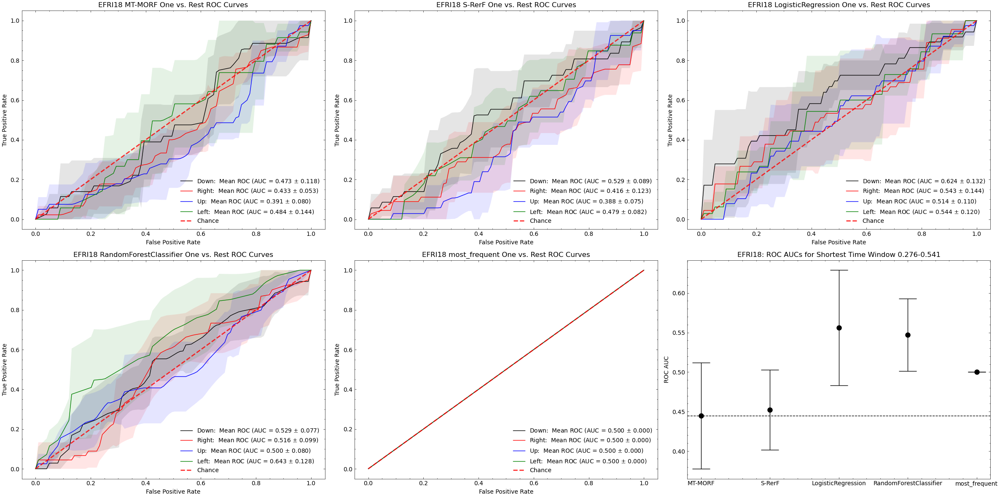

 78%|███████▊  | 7/9 [00:41<00:11,  5.92s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri18/efri18_time_window_tmin=0.276_tmax=0.541_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

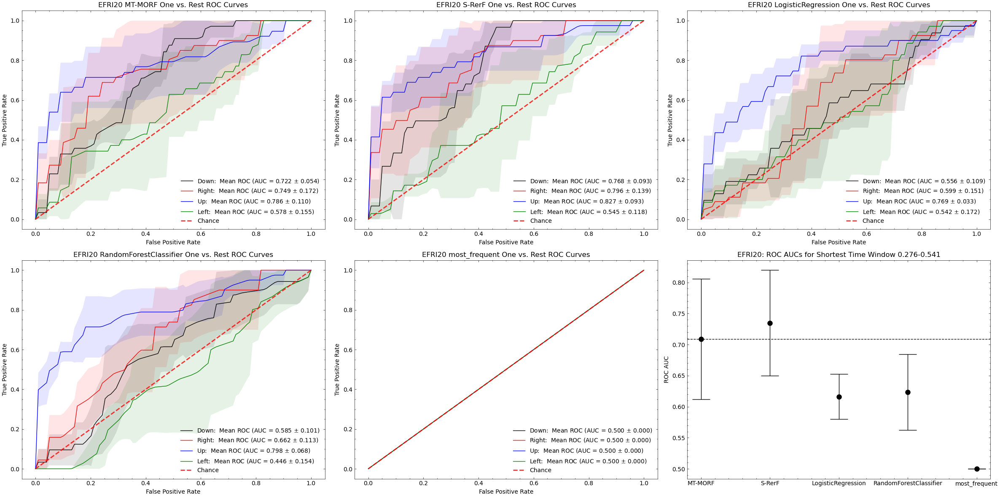

 89%|████████▉ | 8/9 [00:47<00:05,  5.98s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri20/efri20_time_window_tmin=0.276_tmax=0.541_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

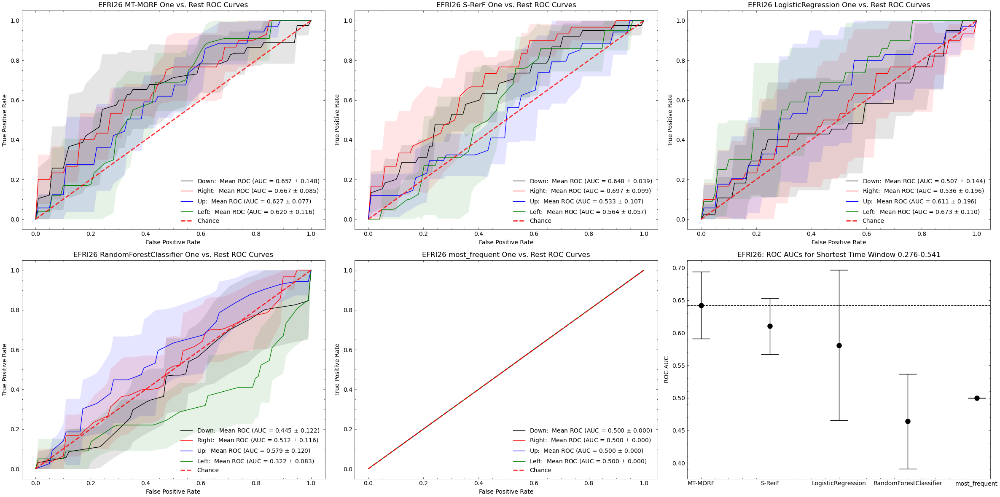

100%|██████████| 9/9 [00:53<00:00,  5.90s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri26/efri26_time_window_tmin=0.276_tmax=0.541_rocs_freq_domain.png



<Figure size 432x288 with 0 Axes>

In [31]:
for subject, clf_scores in tqdm(subject_clf_scores.items()):

    destination = results_path / subject

    X, y = data[subject]

    fig, axs = plt.subplots(nrows=2, ncols=3, dpi=100, figsize=(24, 12))
    axs = axs.flatten()
    for i, (clf_name, scores) in enumerate(clf_scores.items()):
        ax = axs[i]

        plot_roc_multiclass_cv(
            scores["test_predict_proba"],
            X,
            y,
            scores["test_inds"],
            ax=ax,
        )

        ax.set(
            xlabel="False Positive Rate",
            ylabel="True Positive Rate",
            xlim=[-0.05, 1.05],
            ylim=[-0.05, 1.05],
            title=f"{subject.upper()} {clf_name} One vs. Rest ROC Curves",
        )
        ax.legend(loc="lower right")
    
    plot_roc_aucs(clf_scores, ax=axs[-1])
    axs[-1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Shortest Time Window {tmin:.3f}-{tmax:.3f}",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")

## Using patient-specific time-windows

In [23]:
def get_shortest_event_durations_by_patient(bids_root, subjects, label_keyword="Left Target"):
    durations = dict()
    for subject in subjects:
        path_identifiers = dict(
            subject=subject,
            session="efri",
            task="move",
            acquisition="seeg",
            run="01",
            suffix="ieeg",
            extension=".vhdr",
            root=bids_root
        )
        bids_path = BIDSPath(**path_identifiers)
        behav, events = map(pd.DataFrame, get_trial_info(bids_path))
        events.onset = pd.to_numeric(events.onset)
        behav[["successful_trial_flag", "force_magnitude"]] = behav[
            ["successful_trial_flag", "force_magnitude"]
        ].apply(pd.to_numeric)

        # get successful trials and reset index to match those of events_tsv
        successful_trials = behav[behav.successful_trial_flag == 1]
        successful_trials.index = np.arange(len(successful_trials))
        unperturbed_trial_inds = successful_trials.force_magnitude == 0

        # get left target events and compute time difference with adjacent events
        inds = events.trial_type == label_keyword
        go_cue_duration = events.onset.diff(periods=-1).abs()[inds]
        left_target_duration = events.onset.diff(periods=1)[inds]

        # Remove unsuccessful and perturbed trials
        successful_trials = behav[behav.successful_trial_flag == 1]
        successful_trials.index = go_cue_duration.index
        unperturbed_trial_inds = successful_trials.force_magnitude == 0
        go_cue_duration = go_cue_duration[unperturbed_trial_inds]
        left_target_duration = left_target_duration[unperturbed_trial_inds]

        # update durations
        before_duration = min(go_cue_duration)
        after_duration = min(left_target_duration)
        durations[subject] = (before_duration, after_duration)
    
    return durations

In [24]:
durations = get_shortest_event_durations_by_patient(bids_root, subjects)
durations

Out of 135 trials, there were 132 successful trials in /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 97 trials, there were 94 successful trials in /Volumes/Mac/research/data/efri/sub-efri06/ses-efri/ieeg/sub-efri06_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 98 trials, there were 96 successful trials in /Volumes/Mac/research/data/efri/sub-efri07/ses-efri/ieeg/sub-efri07_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 155 trials, there were 143 successful trials in /Volumes/Mac/research/data/efri/sub-efri13/ses-efri/ieeg/sub-efri13_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 163 trials, there were 154 successful trials in /Volumes/Mac/research/data/efri/sub-efri14/ses-efri/ieeg/sub-efri14_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 144 trials, there were 139 successful trials in /Volumes/Mac/research/data/efri/sub-efri15/ses-efri/ieeg/sub-efri15_ses-efri_task-move_acq-seeg_run-01_i

{'efri02': (0.27599999999983993, 0.5410000000001673),
 'efri06': (0.27499999999997726, 0.4214999999999236),
 'efri07': (0.2300000000000182, 0.6589999999999918),
 'efri13': (0.18399999999996908, 0.18650000000002365),
 'efri14': (0.2339999999999236, 0.6205000000001064),
 'efri15': (0.25299999999992906, 0.6025000000000205),
 'efri18': (0.16049999999995634, 0.4134999999998854),
 'efri20': (0.1150000000000091, 0.2595000000001164),
 'efri26': (0.2179999999998472, 0.4470000000001164)}

In [32]:
data2 = dict()
subject_clf_scores2 = dict()

for subject in tqdm(subjects):
    ## Get patient specific windows
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".vhdr",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.25, tmax=tmax+0.25)

    power = tfr_morlet(epochs, freqs=freqs, n_cycles=n_cycles, average=False, return_itc=False, decim=3, n_jobs=-1)
    power.crop(tmin=tmin, tmax=tmax)

    power_data = power.data
    ntrials, nchs, nfreqs, nsteps = power_data.shape
    print(ntrials, nchs, nfreqs, nsteps)
    image_height = nchs * nfreqs
    image_width = nsteps

    X = power_data.reshape(ntrials, -1)
    y = labels

    data2[subject] = (X, y)

    subject_clf_scores2[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

-seeg_run-01_events.tsv.
Reading channel info from /Volumes/Mac/research/data/efri/sub-efri06/ses-efri/ieeg/sub-efri06_ses-efri_task-move_acq-seeg_run-01_channels.tsv.
Reading 0 ... 2525999  =      0.000 ...  1262.999 secs...
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower transition bandwidth: 0.50 Hz
- Upper transition bandwidth: 0.50 Hz
- Filter length: 13201 samples (6.601 sec)

Used Annotations descriptions: ['At Center', 'False Start', 'Go Cue', 'Held Target', 'Hit Target', 'Leave Target', 'Left Target', 'Reserved (End Trial)', 'Reserved (Start Trial)', 'Reward', 'Show Center', 'Speed Fail', 'Speed Feedback', 'Speed Instruction']
Not setting metadata
Not setting metadata
94 matching events found
No baseline correction applied
0 projection items activated
Loading data

  0%|          | 0/9 [00:00<?, ?it/s]

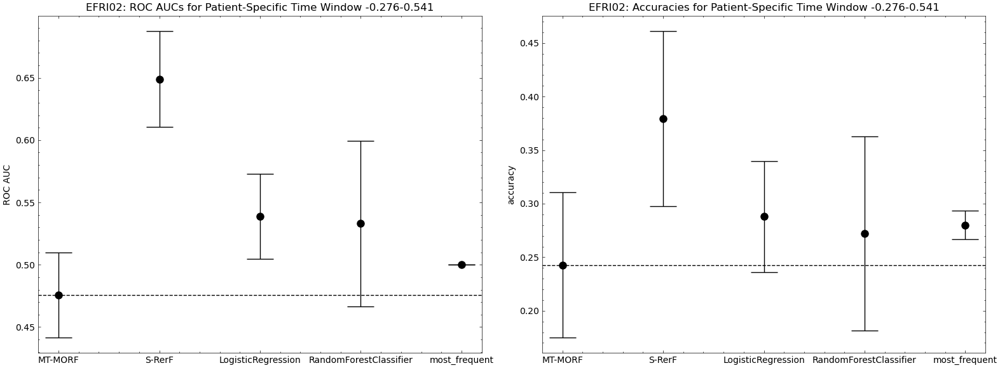

 11%|█         | 1/9 [00:01<00:10,  1.25s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri02/efri02_patient_specific_time_window_tmin=-0.276_tmax=0.541_freq_domain.png


<Figure size 432x288 with 0 Axes>

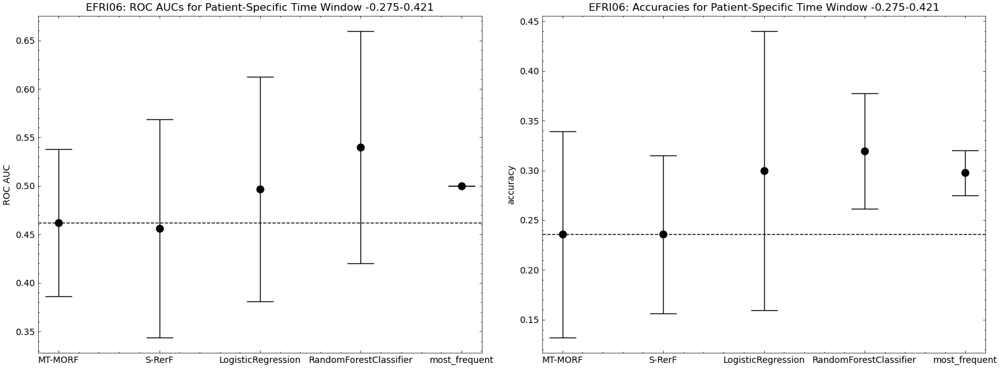

 22%|██▏       | 2/9 [00:02<00:08,  1.28s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri06/efri06_patient_specific_time_window_tmin=-0.275_tmax=0.421_freq_domain.png


<Figure size 432x288 with 0 Axes>

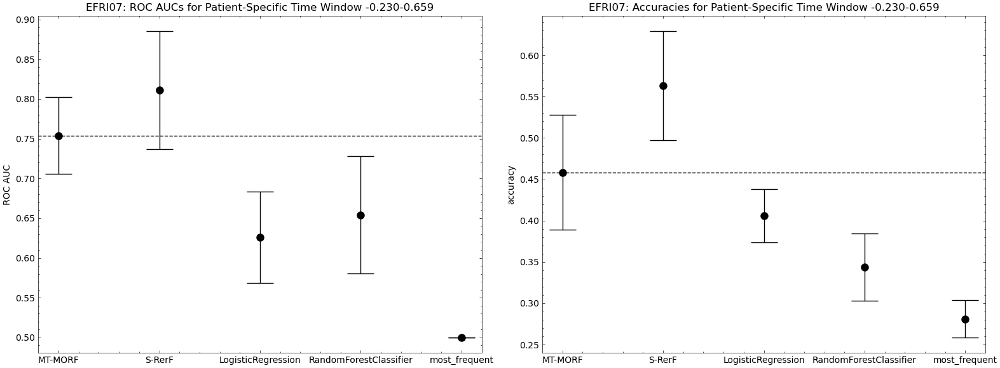

 33%|███▎      | 3/9 [00:03<00:07,  1.31s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri07/efri07_patient_specific_time_window_tmin=-0.230_tmax=0.659_freq_domain.png


<Figure size 432x288 with 0 Axes>

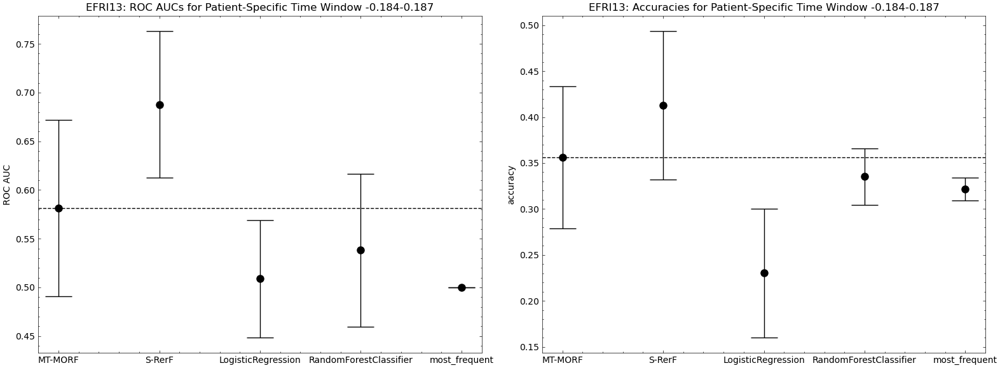

 44%|████▍     | 4/9 [00:05<00:06,  1.28s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri13/efri13_patient_specific_time_window_tmin=-0.184_tmax=0.187_freq_domain.png


<Figure size 432x288 with 0 Axes>

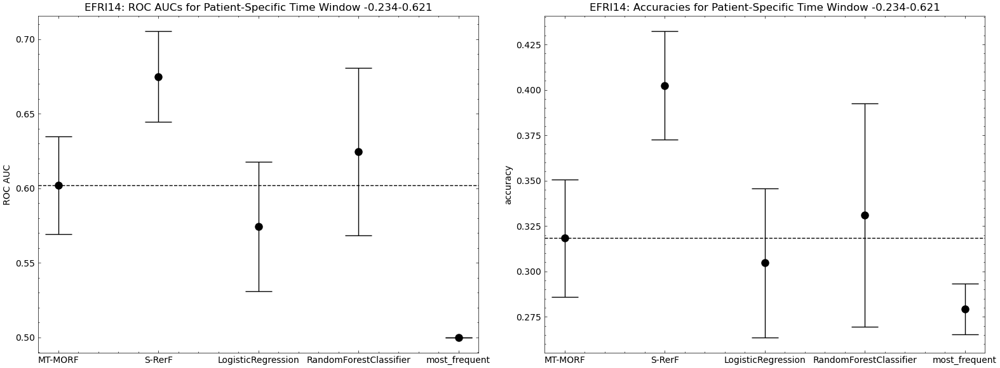

 56%|█████▌    | 5/9 [00:06<00:05,  1.25s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri14/efri14_patient_specific_time_window_tmin=-0.234_tmax=0.621_freq_domain.png


<Figure size 432x288 with 0 Axes>

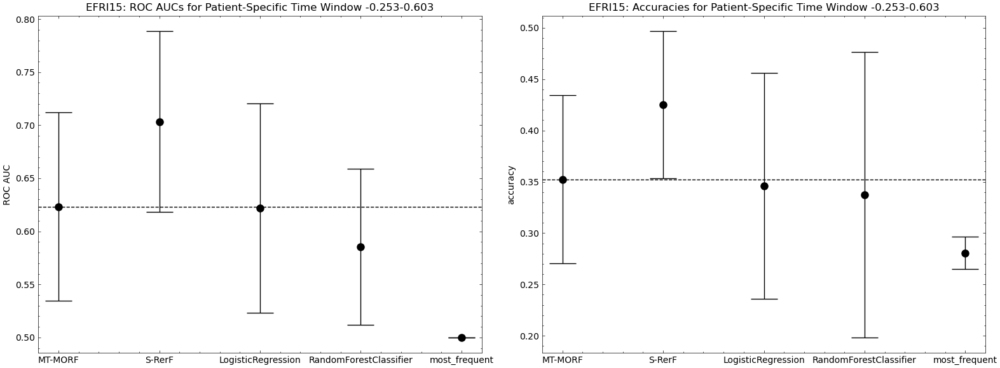

 67%|██████▋   | 6/9 [00:07<00:03,  1.23s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri15/efri15_patient_specific_time_window_tmin=-0.253_tmax=0.603_freq_domain.png


<Figure size 432x288 with 0 Axes>

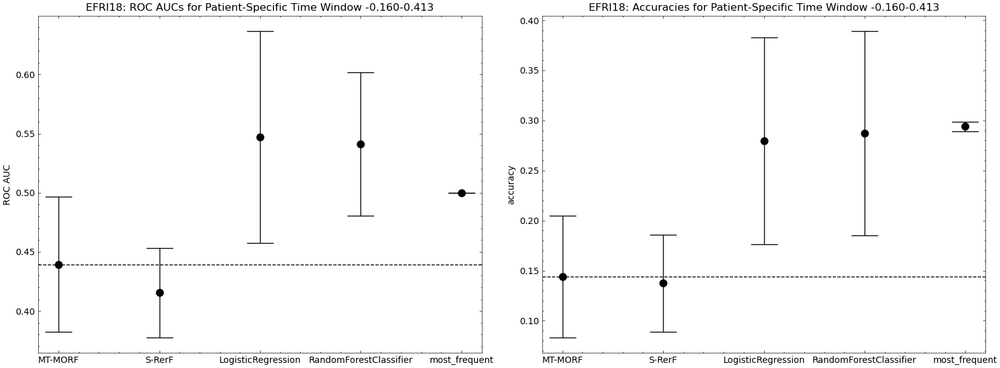

 78%|███████▊  | 7/9 [00:08<00:02,  1.22s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri18/efri18_patient_specific_time_window_tmin=-0.160_tmax=0.413_freq_domain.png


<Figure size 432x288 with 0 Axes>

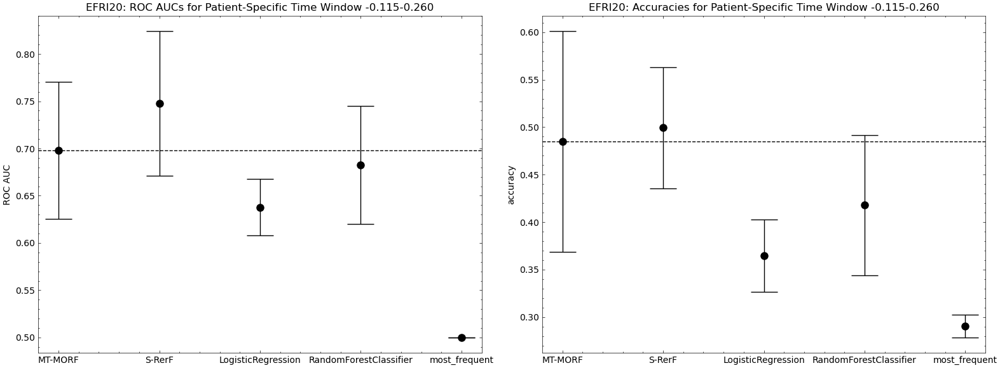

 89%|████████▉ | 8/9 [00:10<00:01,  1.26s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri20/efri20_patient_specific_time_window_tmin=-0.115_tmax=0.260_freq_domain.png


<Figure size 432x288 with 0 Axes>

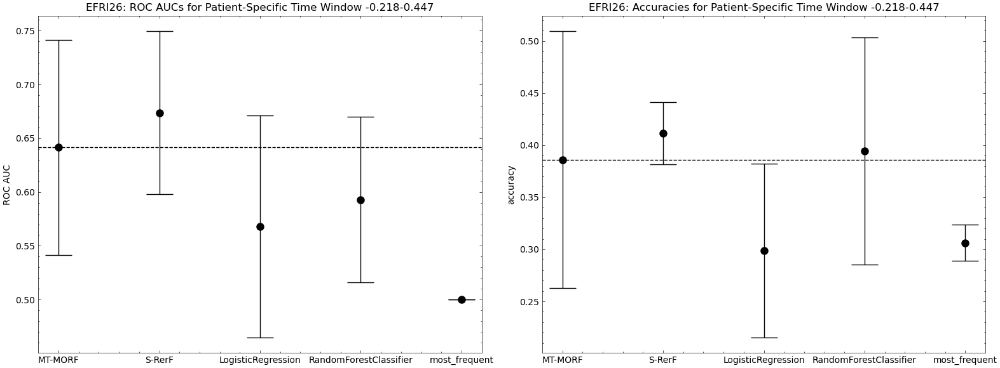

100%|██████████| 9/9 [00:11<00:00,  1.25s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri26/efri26_patient_specific_time_window_tmin=-0.218_tmax=0.447_freq_domain.png



<Figure size 432x288 with 0 Axes>

In [33]:
for subject, clf_scores in tqdm(subject_clf_scores2.items()):

    destination = results_path / subject

    X, y = data2[subject]
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    # 1. Plot ROC AUCs
    fig, axs = plt.subplots(ncols=2, dpi=100, figsize=(16, 6))
    axs = axs.flatten()
    plot_roc_aucs(clf_scores, ax=axs[0])
    axs[0].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )

    # 2. Plot accuracies
    plot_accuracies(clf_scores, ax=axs[1])
    axs[1].set(
        ylabel="accuracy",
        title=f"{subject.upper()}: Accuracies for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")

# Quality of results
- Both markedly non-trivial: efri07,  efri20,
- Both barely non-trivial: efri14, efri15, efri26
- One clf is trivial: efri02, efri13
- Both MT-MORF or S-ReRF is trivial: efri06, efri18

  0%|          | 0/9 [00:00<?, ?it/s]

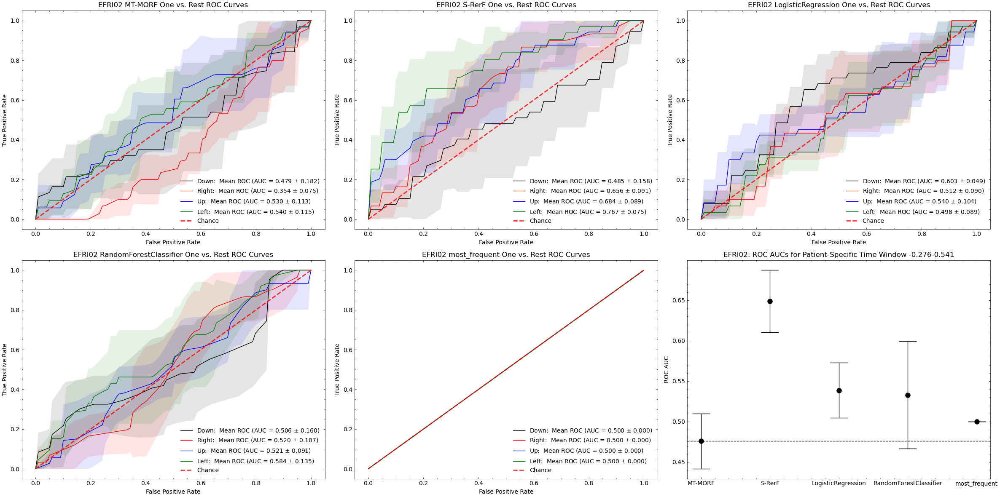

 11%|█         | 1/9 [00:05<00:47,  5.89s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri02/efri02_patient_specific_time_window_tmin=-0.276_tmax=0.541_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

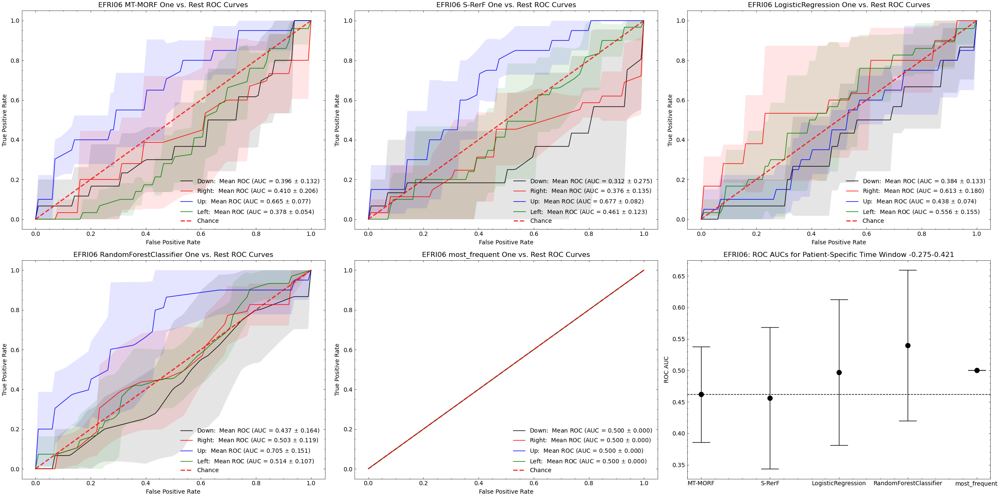

 22%|██▏       | 2/9 [00:11<00:38,  5.50s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri06/efri06_patient_specific_time_window_tmin=-0.275_tmax=0.421_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

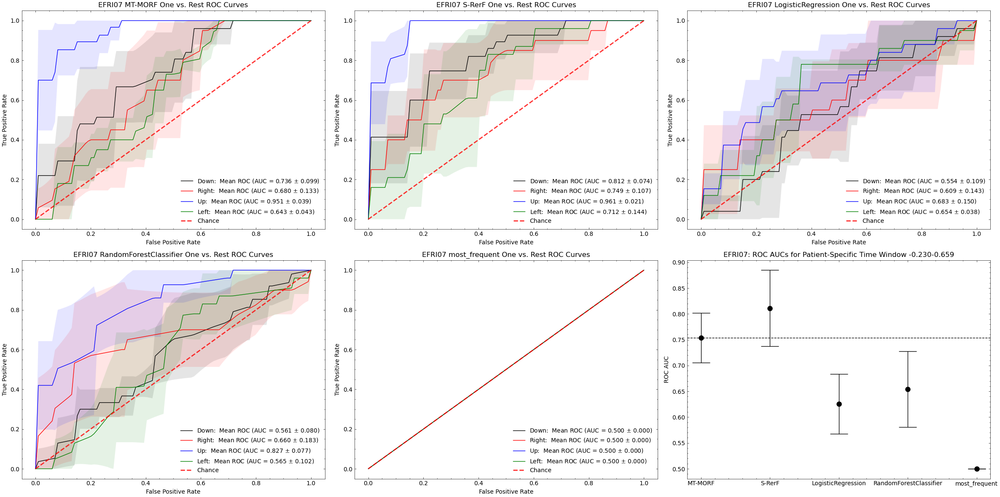

 33%|███▎      | 3/9 [00:16<00:33,  5.58s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri07/efri07_patient_specific_time_window_tmin=-0.230_tmax=0.659_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

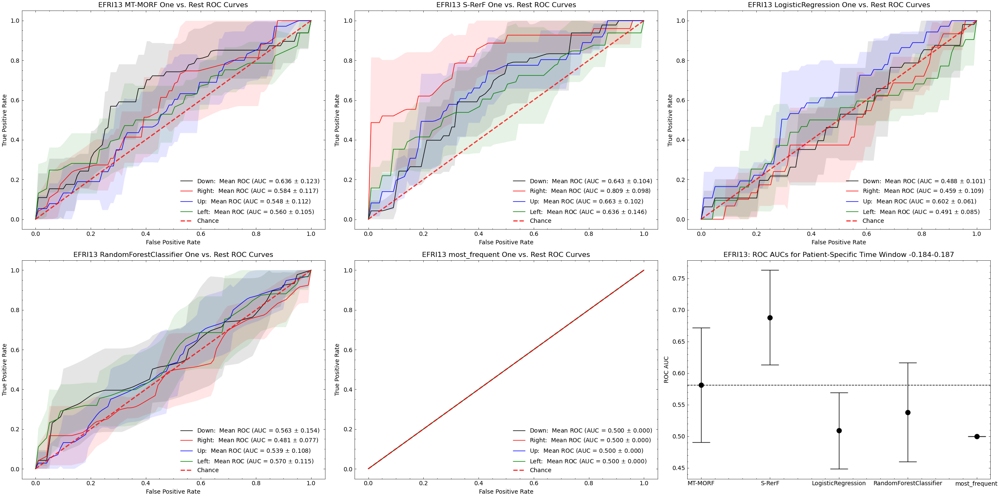

 44%|████▍     | 4/9 [00:22<00:28,  5.67s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri13/efri13_patient_specific_time_window_tmin=-0.184_tmax=0.187_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

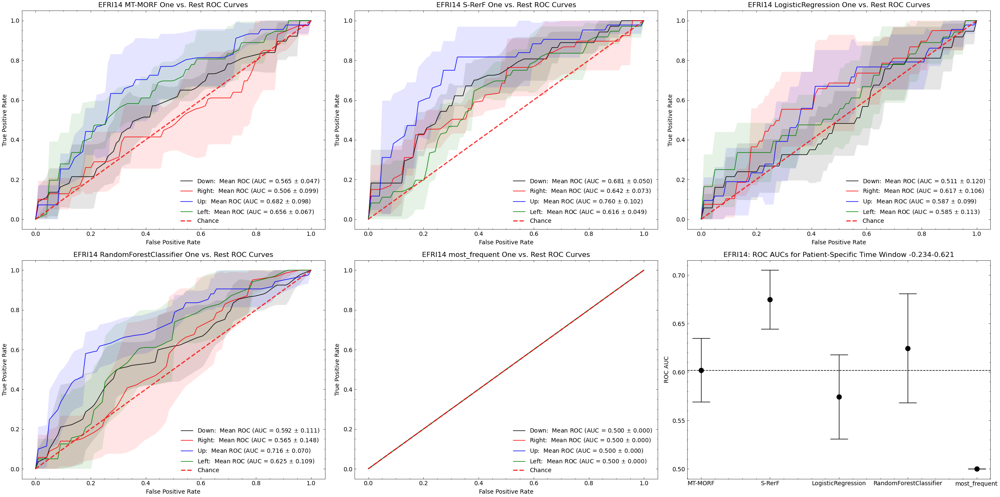

 56%|█████▌    | 5/9 [00:28<00:22,  5.63s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri14/efri14_patient_specific_time_window_tmin=-0.234_tmax=0.621_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

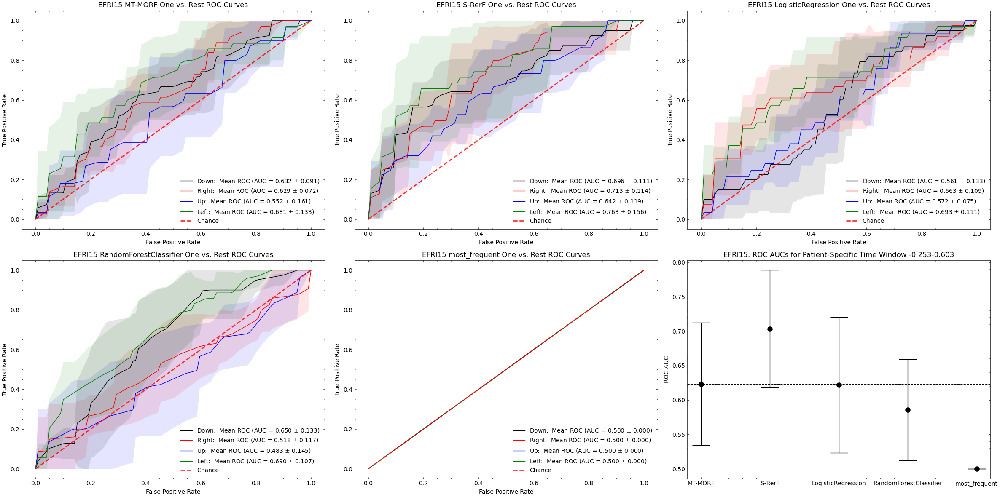

 67%|██████▋   | 6/9 [00:33<00:16,  5.64s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri15/efri15_patient_specific_time_window_tmin=-0.253_tmax=0.603_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

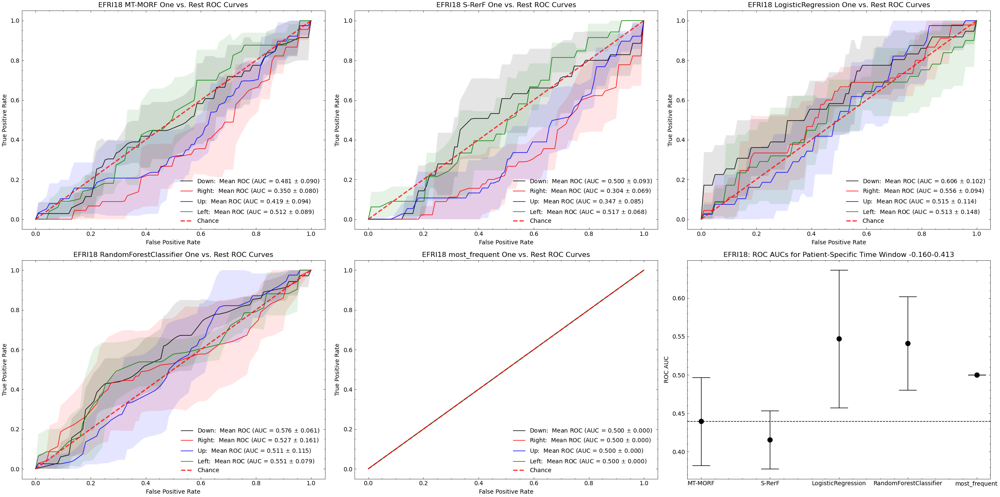

 78%|███████▊  | 7/9 [00:39<00:11,  5.57s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri18/efri18_patient_specific_time_window_tmin=-0.160_tmax=0.413_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

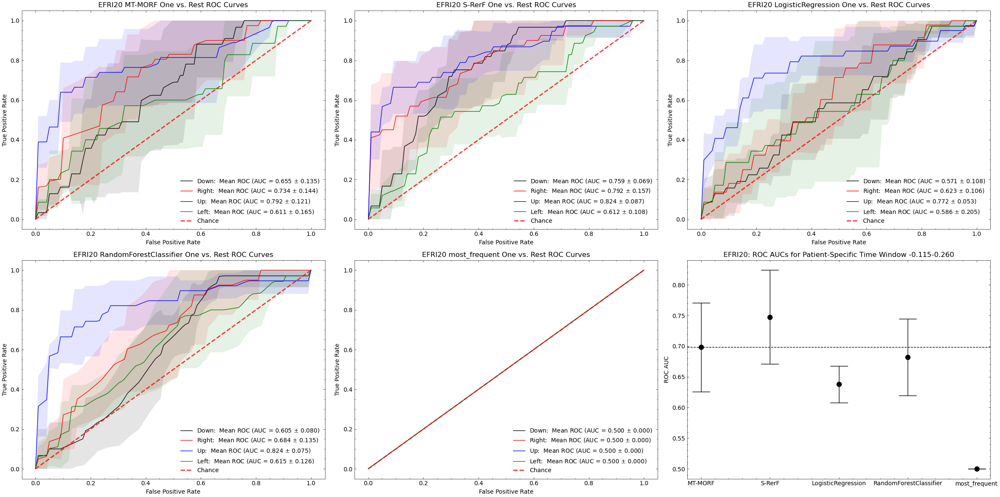

 89%|████████▉ | 8/9 [00:44<00:05,  5.58s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri20/efri20_patient_specific_time_window_tmin=-0.115_tmax=0.260_rocs_freq_domain.png


<Figure size 432x288 with 0 Axes>

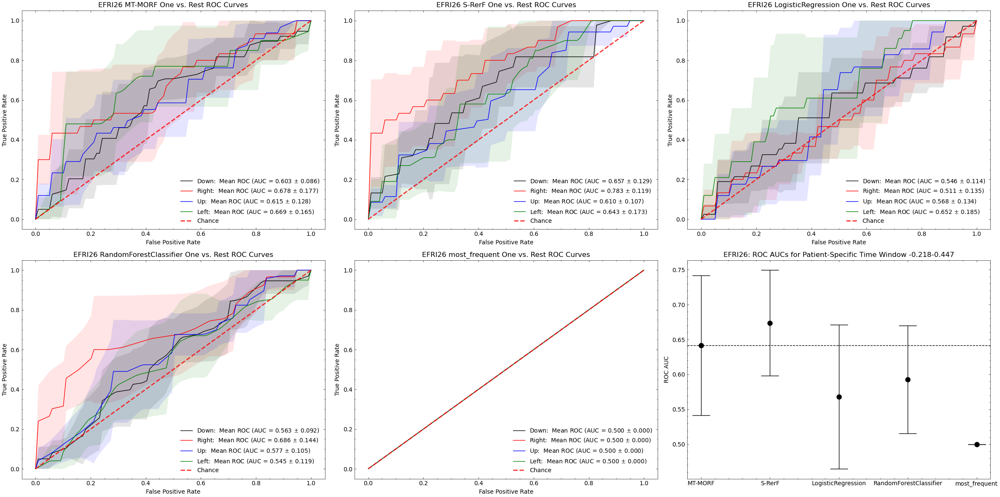

100%|██████████| 9/9 [00:50<00:00,  5.58s/it]Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri26/efri26_patient_specific_time_window_tmin=-0.218_tmax=0.447_rocs_freq_domain.png



<Figure size 432x288 with 0 Axes>

In [34]:
for subject, clf_scores in tqdm(subject_clf_scores2.items()):

    destination = results_path / subject

    X, y = data2[subject]
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    fig, axs = plt.subplots(nrows=2, ncols=3, dpi=100, figsize=(24, 12))
    axs = axs.flatten()
    for i, (clf_name, scores) in enumerate(clf_scores.items()):
        ax = axs[i]

        plot_roc_multiclass_cv(
            scores["test_predict_proba"],
            X,
            y,
            scores["test_inds"],
            ax=ax,
        )

        ax.set(
            xlabel="False Positive Rate",
            ylabel="True Positive Rate",
            xlim=[-0.05, 1.05],
            ylim=[-0.05, 1.05],
            title=f"{subject.upper()} {clf_name} One vs. Rest ROC Curves",
        )
        ax.legend(loc="lower right")
    
    plot_roc_aucs(clf_scores, ax=axs[-1])
    axs[-1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")

In [ ]:
subject_clf_scores2["efri02"]["MT-MORF"].keys()

In [35]:
for subject, clf_scores in tqdm(subject_clf_scores2.items()):

    X, y = data2[subject]

    n_repeats = 5  # number of repeats for permutation importance

    clf_name = mtsmorf.get_params()["projection_matrix"]
    scores = clf_scores[clf_name]

    best_ind = np.argmax(scores["test_accuracy"])
    best_estimator = scores["estimator"][best_ind]
    best_test_inds = scores["test_inds"][best_ind]

    X_test = X[best_test_inds]
    y_test = y[best_test_inds]

    # Run feat importance for Accuracy
    scoring_methods = [
        "roc_auc_ovr",
    ]
    for scoring_method in scoring_methods:
        key_mean = f"validate_{scoring_method}_imp_mean"
        if key_mean not in scores:
            scores[key_mean] = []

        key_std = f"validate_{scoring_method}_imp_std"
        if key_std not in scores:
            scores[key_std] = []

        result = permutation_importance(
            best_estimator,
            X_test,
            y_test,
            scoring=scoring_method,
            n_repeats=n_repeats,
            n_jobs=1,
            random_state=rng,
        )

        imp_std = result.importances_std
        imp_vals = result.importances_mean
        scores[key_mean].append(list(imp_vals))
        scores[key_std].append(list(imp_std))

    clf_scores[clf_name] = scores

  0%|          | 0/9 [00:00<?, ?it/s]


NameError: name 'mtsmorf' is not defined

In [ ]:
for subject in subjects:

    X, y = data2[subject]
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".vhdr",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.25, tmax=tmax+0.25)

    epochs_times = epochs.times

    clf_name = "MT-MORF"
    scoring_method = "roc_auc_ovr"
    result = dict(
        importances_mean=clf_scores[clf_name][
            f"validate_{scoring_method}_imp_mean"
        ],
        importances_std=clf_scores[clf_name][f"validate_{scoring_method}_imp_std"],
    )

    inds = np.where((epochs_times >= tmin) & (epochs_times <= tmax))[0]
    times = epochs_times[inds]

    image_height = nchs * nfreqs
    image_width = len(times)

    ## Plots to help summarize heatmap
    feat_importance_means = np.array(result["importances_mean"]).reshape(
        image_height, image_width
    )
    feat_importance_stds = np.array(result["importances_std"]).reshape(
        image_height, image_width
    )

    id_col = pd.Series(range(1, nchs * nfreqs + 1))
    ch_names_rep = np.repeat(epochs.ch_names, nfreqs)
    freqs_tiled = np.tile(freqs, nchs)
    thr = 0.003

    df_feat_importances = pd.DataFrame(
        {
            "ID": id_col,
            "channel": ch_names_rep,
            "frequency": freqs_tiled,
            "count": np.sum(np.absolute(feat_importance_means) >= thr, axis=1),
        }
    )

    fig, ax = plt.subplots(dpi=300, figsize=(8, 16))

    df_feat_importances['count_by_channel'] = df_feat_importances.groupby(['channel'])['count'].transform('sum')
    srtd_df = df_feat_importances.sort_values(by=["count_by_channel"], ascending=False)

    sns.barplot(x="count_by_channel", y="channel", data=srtd_df, ci=None, ax=ax)
    ax.set(title=f"{subject.upper()}: Count of Time Steps with Mean Importance >= {thr} by Channel", ylabel="channel")

    plt.savefig(
        results_path
        / f"{subject}/tmin={tmin:.3f}_tmax={tmax:.3f}/{clf_name}_feature_importances_freqs_{scoring_method}_summary_channels_thr={thr}.png"
    )
    print(f"Feature importance matrix {scoring_method} summary (channels) for {clf_name} saved.")
    plt.close(fig)

    fig, ax = plt.subplots(dpi=300, figsize=(8, 16))
    df_feat_importances['count_by_freq'] = df_feat_importances.groupby(['frequency'])['count'].transform('sum')
    srtd_df = df_feat_importances.sort_values(by=["count_by_freq"], ascending=False)

    sns.barplot(x="count_by_freq", y="frequency", orient="h", data=srtd_df, ci=None, ax=ax)
    ax.set(title=f"{subject.upper()}: Count of Time Steps with Mean Importance >= {thr} by Frequency", ylabel="frequency")
    plt.savefig(
        results_path
        / f"{subject}/tmin={tmin:.3f}_tmax={tmax:.3f}/{clf_name}_feature_importances_freqs_{scoring_method}_summary_freqs_thr={thr}.png"
    )
    print(f"Feature importance matrix {scoring_method} summary (frequencies) for {clf_name} saved.")
    plt.close(fig)


    id_col = pd.Series(range(1, nchs * nfreqs + 1))
    ch_names_rep = np.repeat(epochs.ch_names, nfreqs)
    freqs_tiled = np.tile(freqs, nchs)

    df_feat_importances = pd.DataFrame(
        {
            "ID": id_col,
            "channel": ch_names_rep,
            "frequency": freqs_tiled,
            "count": np.sum(np.absolute(feat_importance_means) > 0, axis=1),
        }
    )

    fig, ax = plt.subplots(dpi=300, figsize=(8, 16))

    df_feat_importances['count_by_channel'] = df_feat_importances.groupby(['channel'])['count'].transform('sum')
    srtd_df = df_feat_importances.sort_values(by=["count_by_channel"], ascending=False)

    sns.barplot(x="count_by_channel", y="channel", data=srtd_df, ci=None, ax=ax)
    ax.set(title=f"{subject.upper()}: Count of Time Steps with Nonzero Mean Importance by Channel", ylabel="channel")

    plt.savefig(
        results_path
        / f"{subject}/tmin={tmin:.3f}_tmax={tmax:.3f}/{clf_name}_feature_importances_freqs_{scoring_method}_summary_channels_nonzero.png"
    )
    print(f"Feature importance matrix {scoring_method} summary (channels) for {clf_name} saved.")
    plt.close(fig)


    fig, ax = plt.subplots(dpi=300, figsize=(8, 16))
    df_feat_importances['count_by_freq'] = df_feat_importances.groupby(['frequency'])['count'].transform('sum')
    srtd_df = df_feat_importances.sort_values(by=["count_by_freq"], ascending=False)

    sns.barplot(x="count_by_freq", y="frequency", orient="h", data=srtd_df, ci=None, ax=ax)
    ax.set(title=f"{subject.upper()}: Count of Time Steps with Nonzero Mean Importance by Frequency", ylabel="frequency")
    plt.savefig(
        results_path
        / f"{subject}/tmin={tmin:.3f}_tmax={tmax:.3f}/{clf_name}_feature_importances_freqs_{scoring_method}_summary_freqs_nonzero.png"
    )
    print(f"Feature importance matrix {scoring_method} summary (frequencies) for {clf_name} saved.")
    plt.close(fig)

    fig, ax = plt.subplots(dpi=300, figsize=(20, 80))

    ## Plot full feat importance heatmap
    ch_names = [f"{ch}-{freq:.1f}" for ch in epochs.ch_names for freq in freqs]
    plot_feature_importances(
        result, ch_names, times, nchs * nfreqs, len(times), ax=ax
    )
    ax.set(title=f"{subject.upper()}: Feature Importances {scoring_method}")
    fig.tight_layout()

    plt.savefig(
        results_path
        / f"{subject}/tmin={tmin:.3f}_tmax={tmax:.3f}/{clf_name}_feature_importances_freqs_{scoring_method}.png"
    )
    print(f"Feature importance matrix {scoring_method} for {clf_name} saved.")
    plt.close(fig)